## 1) Importação das bibliotecas

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import cv2 as cv
import imageio
import imutils
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import glob
import os
cv.ocl.setUseOpenCL(False)

## 2) Calibração individual das câmeras

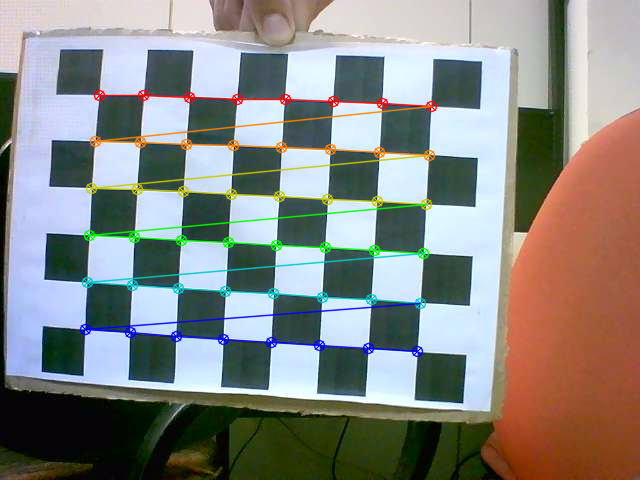

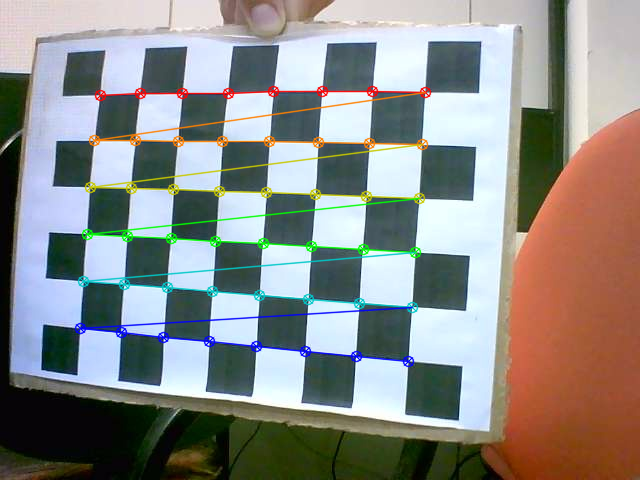

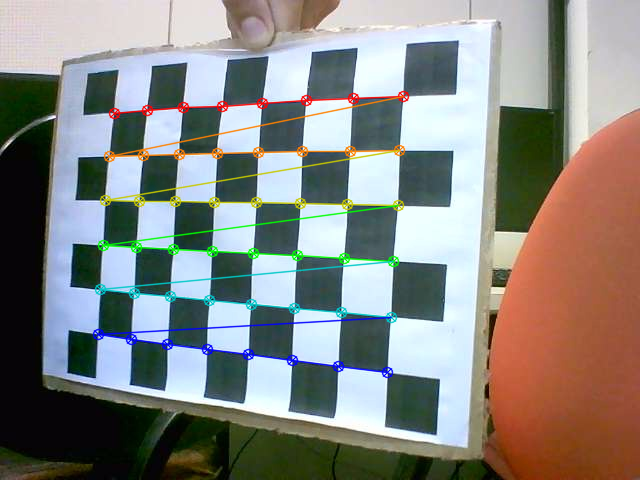

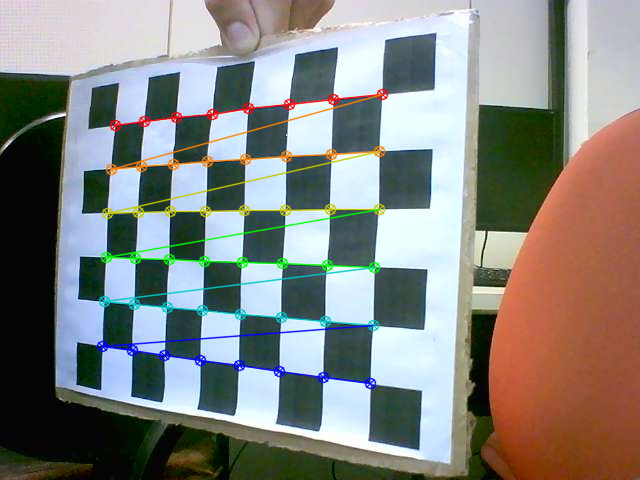

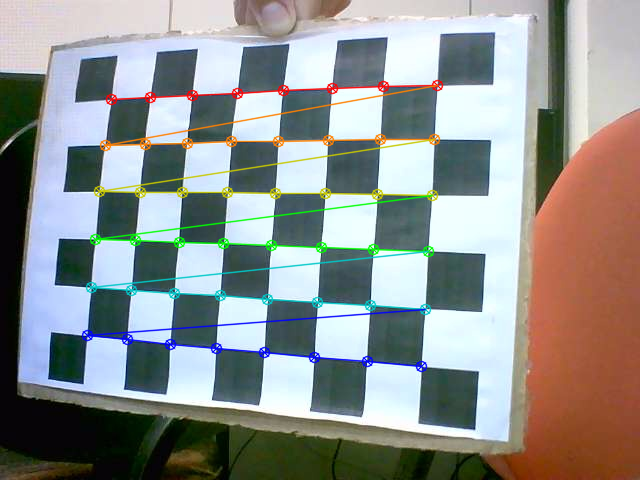

...

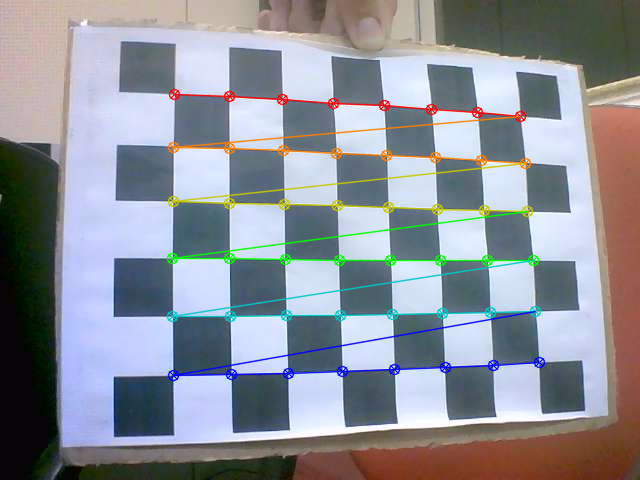

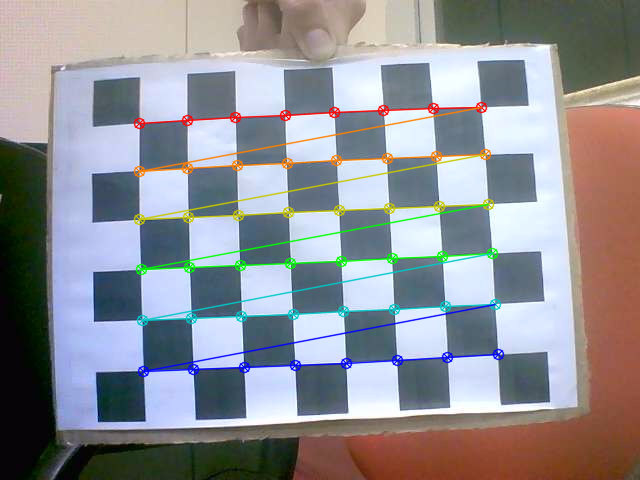

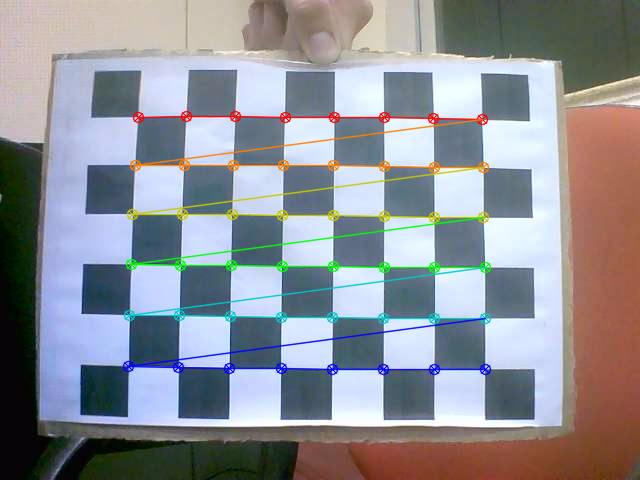

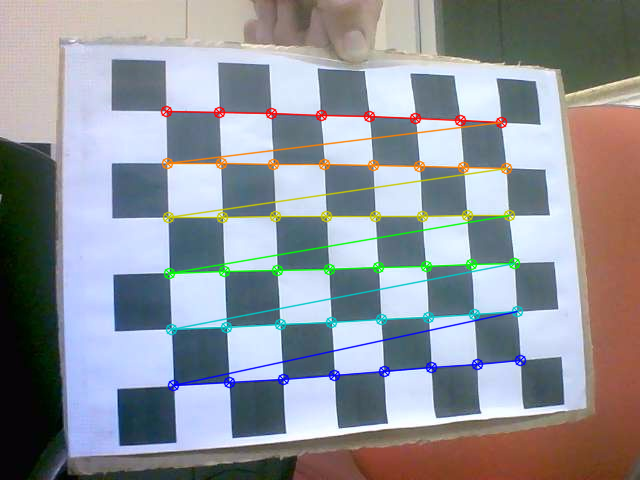

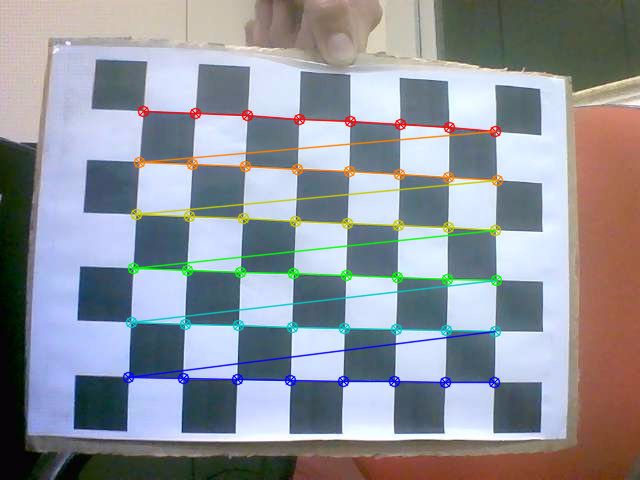

In [ ]:
# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*8,3), np.float32)
objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints_E = [] # 3d point in real world space
imgpoints_E = [] # 2d points in image plane.

objpoints_D = [] # 3d point in real world space
imgpoints_D = [] # 2d points in image plane.

images_E_directory = '/content/drive/MyDrive/SistemaDualCameras/webcam_esquerda'
images_D_directory = '/content/drive/MyDrive/SistemaDualCameras/webcam_direita'

images_E = glob.glob( os.path.join(images_E_directory, '*.jpg') )
images_D = glob.glob( os.path.join(images_D_directory, '*.jpg') )


for fname in images_E:
    img = cv.imread(fname)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    # Find the chess board corners
    ret, corners = cv.findChessboardCorners(gray, (8,6), None)

    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints_E.append(objp)
        corners2 = cv.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints_E.append(corners2)
        # Draw and display the corners
        cv.drawChessboardCorners(img, (8,6), corners2, ret)
        cv2_imshow(img)
        cv.waitKey(500)

for fname in images_D:
    img = cv.imread(fname)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    # Find the chess board corners
    ret, corners = cv.findChessboardCorners(gray, (8,6), None)

    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints_D.append(objp)
        corners2 = cv.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints_D.append(corners2)
        # Draw and display the corners
        cv.drawChessboardCorners(img, (8,6), corners2, ret)
        cv2_imshow(img)
        cv.waitKey(500)

cv.destroyAllWindows()

In [ ]:
retE, mtxE, distE, rvecsE, tvecsE = cv.calibrateCamera(objpoints_E, imgpoints_E, gray.shape[::-1], None, None)

In [ ]:
retD, mtxD, distD, rvecsD, tvecsD = cv.calibrateCamera(objpoints_D, imgpoints_D, gray.shape[::-1], None, None)

In [ ]:
# POI
with open("OUTPUT2.txt", "w") as f:
  print('Parâmetros de Orientação Interior(POI):\n\n',
  'Câmera de referência(esquerda):\n\n',
  f'Erro RMS:{retE}\n\n',
  f'\n fx = {mtxE[0,0]}\n fy = {mtxE[1,1]}\n Xo = {mtxE[0,2]}\n Yo = {mtxE[1,2]}\n\n Coeficientes de distorção:\n k1 = {distE[0,0]},\n k2 = {distE[0,1]},\n k3 = {distE[0,4]},\n p1 = {distE[0,2]},\n p2 = {distE[0,3]}\n\n',
  'Câmera k(direita):\n\n',
  f'Erro RMS:{retD}\n\n',
  f'\n fx = {mtxD[0,0]}\n fy = {mtxD[1,1]}\n Xo = {mtxD[0,2]}\n Yo = {mtxD[1,2]}\n\n Coeficientes de distorção:\n k1 = {distD[0,0]},\n k2 = {distD[0,1]},\n k3 = {distD[0,4]},\n p1 = {distD[0,2]},\n p2 = {distD[0,3]}', file=f)

In [ ]:
SensorWidth = 5.9961 * 1e-3 # Em mm
SensorHeight = 4.5000 * 1e-3 # Em mm
fxE = mtxE[0,0]
fyE = mtxD[1,1]
fE = fxE * ((SensorWidth / 640) + fyE * (SensorHeight / 480)) / 2
XoE = mtxE[0,2]
YoE = mtxE[1,2]

SensorWidth = 5.9961 * 1e-3 # Em mm
SensorHeight = 4.5000 * 1e-3 # Em mm
XoD = mtxD[0,2]
YoD = mtxD[1,2]
fxD = mtxD[0,0]
fyD = mtxD[1,1]
fD = fxD * ((SensorWidth / 640) + fyD * (SensorHeight / 480)) / 2

print(fE, fD, XoE, YoE, XoD, YoD) # Em mm

2.9667515801201083 3.1041688617134526 331.2274833298561 256.3426698999249 337.2743796827855 223.4454199084205


In [ ]:
imgE = cv.imread('/content/drive/MyDrive/SistemaDualCameras/imgs_para_gerar_virtual/photo2_E.jpg')
hE,  wE = imgE.shape[:2]
newcameramtxE, roiE = cv.getOptimalNewCameraMatrix(mtxE, distE, (wE,hE), 1, (wE,hE))

imgD = cv.imread('/content/drive/MyDrive/SistemaDualCameras/imgs_para_gerar_virtual/photo2_D.jpg')
hD,  wD = imgD.shape[:2]
newcameramtxD, roiD = cv.getOptimalNewCameraMatrix(mtxD, distD, (wD,hD), 1, (wD,hD))

In [ ]:
# undistort
dstE = cv.undistort(imgE, mtxE, distE, None, newcameramtxE)
dstD = cv.undistort(imgD, mtxD, distD, None, newcameramtxD)
# crop the image
xE, yE, wE, hE = roiE
dstE_c = dstE[yE:yE+hE, xE:xE+wE]
imgE_c = cv.imwrite('img1E_ret.png', dstE_c)

xD, yD, wD, hD = roiD
dstD_c = dstD[yD:yD+hD, xD:xD+wD]
imgD_c = cv.imwrite('img1D_ret.png', dstD_c)

## 3) Estimativa dos parâmetros de montagem do sistema

### Utilizando StereoCalibrate da OpenCV

In [ ]:
def stereo_calibrate(mtx0, dist0, mtx1, dist1, c0_images_names, c1_images_names):

    #open images
    c0_images = [cv.imread(imname, 1) for imname in c0_images_names]
    c1_images = [cv.imread(imname, 1) for imname in c1_images_names]

    #change this if stereo calibration not good.
    criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 100, 0.001)

    #coordinates of squares in the checkerboard world space
    objp = np.zeros((8*6,3), np.float32)
    objp[:,:2] = np.mgrid[0:8,0:6].T.reshape(-1,2)
    objp = 2.80* objp

    #frame dimensions. Frames should be the same size.
    width = c0_images[0].shape[1]
    height = c0_images[0].shape[0]

    #Pixel coordinates of checkerboards
    imgpoints_left = [] # 2d points in image plane.
    imgpoints_right = []

    #coordinates of the checkerboard in checkerboard world space.
    objpoints = [] # 3d point in real world space

    for frame0, frame1 in zip(c0_images, c1_images):
        gray1 = cv.cvtColor(frame0, cv.COLOR_BGR2GRAY)
        gray2 = cv.cvtColor(frame1, cv.COLOR_BGR2GRAY)
        c_ret1, corners1 = cv.findChessboardCorners(gray1, (8, 6), None)
        c_ret2, corners2 = cv.findChessboardCorners(gray2, (8, 6), None)

        if c_ret1 == True and c_ret2 == True:

            objpoints.append(objp)

            corners1 = cv.cornerSubPix(gray1, corners1, (11, 11), (-1, -1), criteria)
            corners2 = cv.cornerSubPix(gray2, corners2, (11, 11), (-1, -1), criteria)

            imgpoints_left.append(corners1)
            imgpoints_right.append(corners2)

    stereocalibration_flags = cv.CALIB_FIX_INTRINSIC
    ret, CM1, dist0, CM2, dist1, R, T, E, F = cv.stereoCalibrate(objpoints, imgpoints_left, imgpoints_right, mtx0, dist0,
                                                                 mtx1, dist1, (width, height), criteria = criteria, flags = stereocalibration_flags)

    print('rmse: ', ret)
    cv.destroyAllWindows()
    return ret, CM1, dist0, CM2, dist1, R, T, E, F

In [ ]:
ret, CM1, dist0, CM2, dist1, R, T, E, F = stereo_calibrate(mtxE, distE, mtxD, distD, images_E, images_D)
R, T
# T_dist = np.sqrt(T[0]**2+T[1]**2+T[2]**2)
# print(T_dist)

rmse:  0.4498851404119639


(array([[ 0.90086216,  0.0537627 , -0.4307632 ],
        [-0.02298803,  0.99681715,  0.07633553],
        [ 0.43349615, -0.05886539,  0.89923076]]),
 array([[21.03022281],
        [-0.54740593],
        [ 6.65931237]]))

### Tentativa 2: Utilizando a média dos POR obtidos com os POEs para cada para de imagem ( Resultado incorreto )

In [ ]:
#Parâmetros de orientação exterior (Primeiro par de imagens)

print(f'O número de pares de imagens utilizadas foi igual a {len(rvecsE)}\n')
# Parâmetros de montagem do conjunto dual de câmeras
lever_arm = np.zeros((3, 1))
boresight = np.zeros((3, 3))
for i in range(len(rvecsE)):
  Rm_cref = cv.Rodrigues(rvecsE[i])[0]
  Rm_ck = cv.Rodrigues(rvecsD[i])[0]
  rm_cref = tvecsE[i]
  rm_ck = tvecsD[i]

  lever_arm += np.linalg.inv(Rm_cref) @ (rm_ck - rm_cref)
  boresight += np.linalg.inv(Rm_cref) @ Rm_ck

lever_arm = lever_arm / len(rvecsE)
boresight = boresight / len(rvecsE)
print(f'lever-arm:\n {lever_arm}\n\nboresight:\n  {boresight}')
soma_lever_arm = np.sqrt(lever_arm[0]**2+lever_arm[1]**2+lever_arm[2]**2)
print(soma_lever_arm)

O número de pares de imagens utilizadas foi igual a 15

lever-arm:
 [[ 1.0943455 ]
 [ 1.1661162 ]
 [-0.70533732]]

boresight:
  [[ 0.90067344  0.10239274 -0.42168179]
 [-0.07139828  0.99313745  0.08853533]
 [ 0.42784273 -0.04977209  0.90231461]]
[1.74783288]


## 4) Obteção da imagem virtual

### Utilizando SIFT e FindHomography da OpenCV

In [ ]:
# Foi capturado 1 par de imagens tiradas simultaneamente
img_E_dir = '/content/drive/MyDrive/SistemaDualCameras/imgs_para_gerar_virtual/photo1_E.jpg'
img_D_dir = '/content/drive/MyDrive/SistemaDualCameras/imgs_para_gerar_virtual/photo1_D.jpg'

In [ ]:
# select the image id (valid values 1,2,3, or 4)
feature_extractor = 'sift' # one of 'sift', 'surf', 'brisk', 'orb'
feature_matching = 'knn'

<ipython-input-489-d8cfb6f76719>:3: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  trainImg = imageio.imread(img_D_dir)
<ipython-input-489-d8cfb6f76719>:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  queryImg = imageio.imread(img_E_dir)


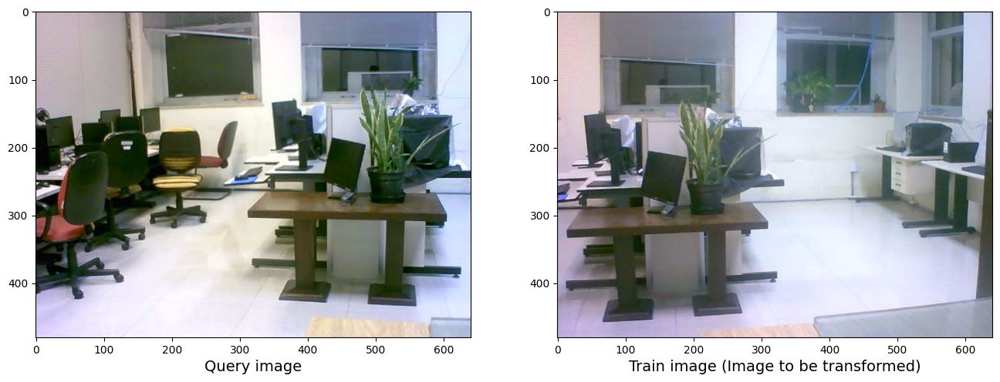

In [ ]:
# read images and transform them to grayscale
# Make sure that the train image is the image that will be transformed
trainImg = imageio.imread(img_D_dir)
trainImg_gray = cv.cvtColor(trainImg, cv.COLOR_RGB2GRAY)

queryImg = imageio.imread(img_E_dir)
# Opencv defines the color channel in the order BGR.
# Transform it to RGB to be compatible to matplotlib
queryImg_gray = cv.cvtColor(queryImg, cv.COLOR_RGB2GRAY)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
ax1.imshow(queryImg, cmap="gray")
ax1.set_xlabel("Query image", fontsize=14)

ax2.imshow(trainImg, cmap="gray")
ax2.set_xlabel("Train image (Image to be transformed)", fontsize=14)

plt.show()

print()

In [ ]:
def detectAndDescribe(image, method=None):
    """
    Compute key points and feature descriptors using an specific method
    """

    assert method is not None, "You need to define a feature detection method. Values are: 'sift', 'surf'"

    # detect and extract features from the image
    if method == 'sift':
        descriptor = cv.xfeatures2d.SIFT_create()
    elif method == 'surf':
        descriptor = cv.xfeatures2d.SURF_create()
    elif method == 'brisk':
        descriptor = cv.BRISK_create()
    elif method == 'orb':
        descriptor = cv.ORB_create()

    # get keypoints and descriptors
    (kps, features) = descriptor.detectAndCompute(image, None)

    return (kps, features)

In [ ]:
kpsA, featuresA = detectAndDescribe(trainImg_gray, method=feature_extractor)
kpsB, featuresB = detectAndDescribe(queryImg_gray, method=feature_extractor)

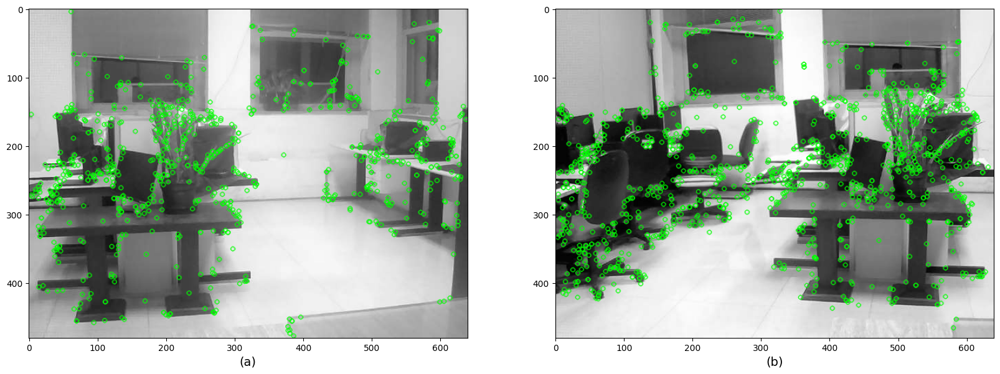

In [ ]:
# display the keypoints and features detected on both images
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
ax1.imshow(cv.drawKeypoints(trainImg_gray,kpsA,None,color=(0,255,0)))
ax1.set_xlabel("(a)", fontsize=14)
ax2.imshow(cv.drawKeypoints(queryImg_gray,kpsB,None,color=(0,255,0)))
ax2.set_xlabel("(b)", fontsize=14)

plt.show()

In [ ]:
def createMatcher(method,crossCheck):
    "Create and return a Matcher Object"

    if method == 'sift' or method == 'surf':
        bf = cv.BFMatcher(cv.NORM_L2, crossCheck=crossCheck)
    elif method == 'orb' or method == 'brisk':
        bf = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=crossCheck)
    return bf

In [ ]:
def matchKeyPointsBF(featuresA, featuresB, method):
    bf = createMatcher(method, crossCheck=True)

    # Match descriptors.
    best_matches = bf.match(featuresA,featuresB)

    # Sort the features in order of distance.
    # The points with small distance (more similarity) are ordered first in the vector
    rawMatches = sorted(best_matches, key = lambda x:x.distance)
    print("Raw matches (Brute force):", len(rawMatches))
    return rawMatches

In [ ]:
def matchKeyPointsKNN(featuresA, featuresB, ratio, method):
    bf = createMatcher(method, crossCheck=False)
    # compute the raw matches and initialize the list of actual matches
    rawMatches = bf.knnMatch(featuresA, featuresB, 2)
    print("Raw matches (knn):", len(rawMatches))
    matches = []
    # loop over the raw matches
    for m,n in rawMatches:
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if m.distance < n.distance * ratio:
            matches.append(m)
    return matches

Using: knn feature matcher
Raw matches (knn): 775


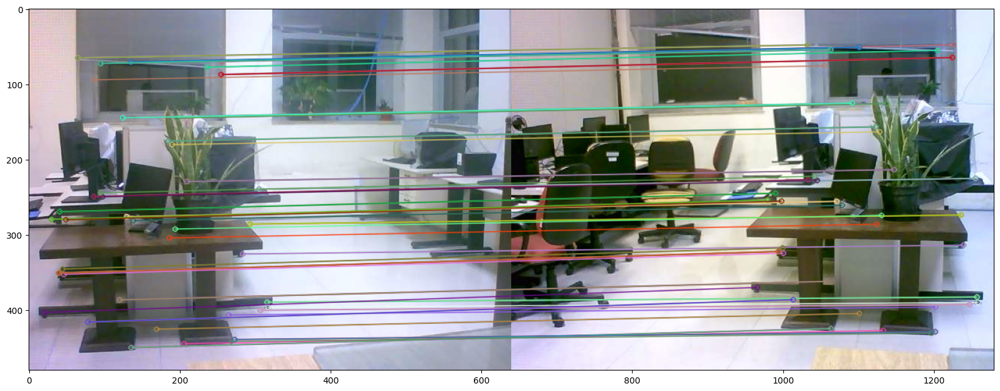

In [ ]:
print("Using: {} feature matcher".format(feature_matching))

fig = plt.figure(figsize=(20,8))

if feature_matching == 'bf':
    matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
    img3 = cv.drawMatches(trainImg,kpsA,queryImg,kpsB,matches[:100],
                           None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
elif feature_matching == 'knn':
    matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.52, method=feature_extractor)
    img3 = cv.drawMatches(trainImg,kpsA,queryImg,kpsB,np.random.choice(matches,100),
                           None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


plt.imshow(img3)
plt.show()

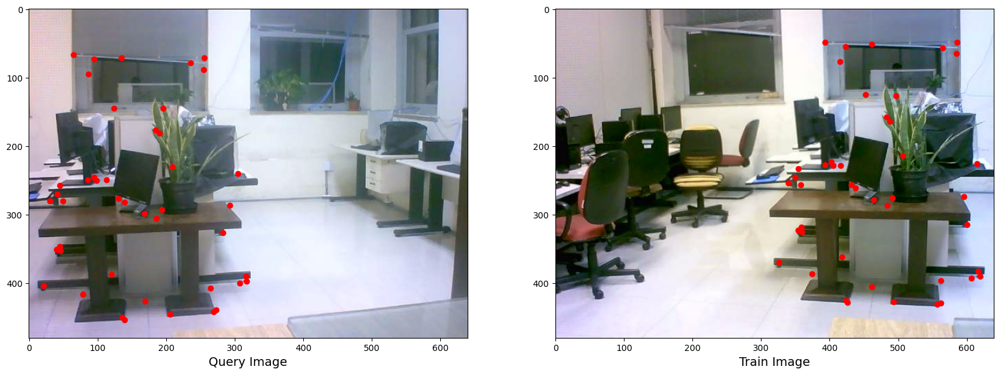

Foram obtidos 45 pontos homólogos entre as imagens


In [ ]:
# Initialize lists
list_kpsA = []
list_kpsB = []

# For each match...
for mat in matches:

    # Get the matching keypoints for each of the images
    imgA_idx = mat.queryIdx
    imgB_idx = mat.trainIdx

    # x - columns
    # y - rows
    # Get the coordinates
    (xA, yA) = kpsA[imgA_idx].pt
    (xB, yB) = kpsB[imgB_idx].pt

    # Append to each list
    list_kpsA.append((xA, yA))
    list_kpsB.append((xB, yB))

list_kpsA = [(round(list_kpsA_unit[0]),round(list_kpsA_unit[1])) for list_kpsA_unit in list_kpsA]
list_kpsB = [(round(list_kpsB_unit[0]),round(list_kpsB_unit[1])) for list_kpsB_unit in list_kpsB]

array_kpsA = np.array(list_kpsA)
array_kpsB = np.array(list_kpsB)

imgA = cv.imread(img_D_dir)
imgB = cv.imread(img_E_dir)

# display the keypoints and features detected on both images
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)

ax1.imshow(imgA[:,:,[2,1,0]])
ax1.scatter(array_kpsA[:,0], array_kpsA[:,1], color='red')
ax1.set_xlabel("Query Image", fontsize=14)
#ax1.axis('off')

ax2.imshow(imgB[:,:,[2,1,0]])
ax2.scatter(array_kpsB[:,0], array_kpsB[:,1], color='red')
ax2.set_xlabel("Train Image", fontsize=14)
#ax2.axis('off')

plt.show()

print(f'Foram obtidos {len(array_kpsA)} pontos homólogos entre as imagens')

In [ ]:
def getHomography(kpsA, kpsB, featuresA, featuresB, matches, reprojThresh):
    # convert the keypoints to numpy arrays
    kpsA = np.float32([kp.pt for kp in kpsA])
    kpsB = np.float32([kp.pt for kp in kpsB])

    if len(matches) > 4:

        # construct the two sets of points
        ptsA = np.float32([kpsA[m.queryIdx] for m in matches])
        ptsB = np.float32([kpsB[m.trainIdx] for m in matches])

        # estimate the homography between the sets of points
        (H, status) = cv.findHomography(ptsA, ptsB, cv.RANSAC,
            reprojThresh)

        return (matches, H, status)
    else:
        return None

In [ ]:
M = getHomography(kpsA, kpsB, featuresA, featuresB, matches, reprojThresh=4)
if M is None:
    print("Error!")
(matches, H, status) = M
print(H)

[[ 7.87675726e-01 -6.81136070e-02  3.36190225e+02]
 [-5.10913425e-02  9.61666521e-01 -1.20038654e+01]
 [-3.73922606e-04  5.77055597e-05  1.00000000e+00]]


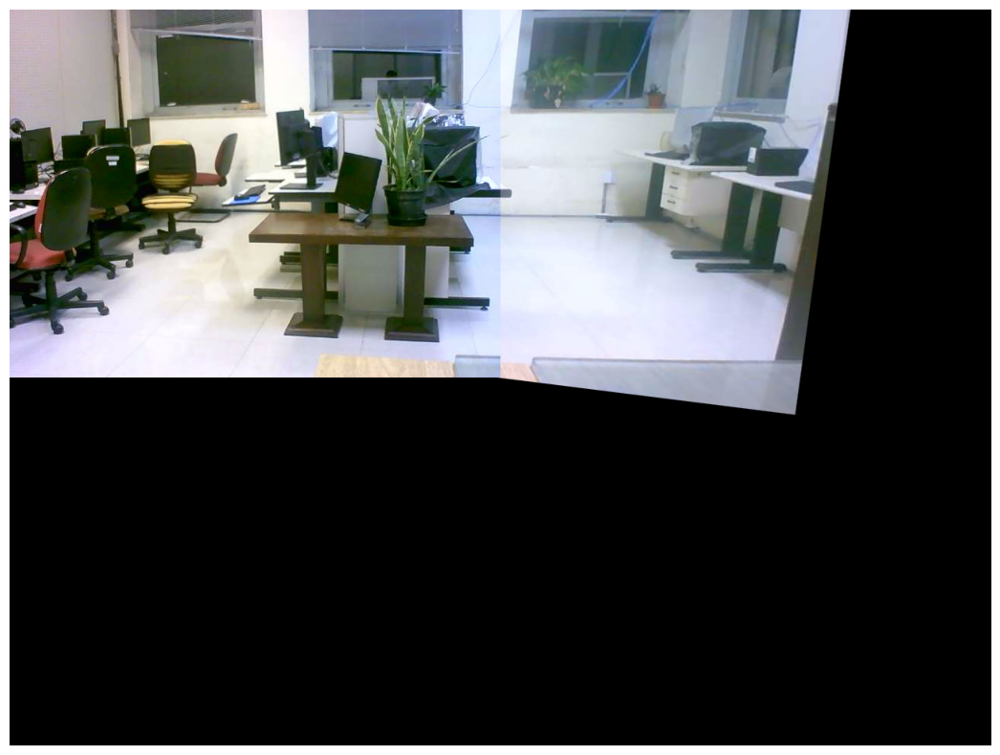

In [ ]:
# Apply panorama correction
width = trainImg.shape[1] + queryImg.shape[1]
height = trainImg.shape[0] + queryImg.shape[0]

result = cv.warpPerspective(trainImg, H, (width, height))
result[0:queryImg.shape[0], 0:queryImg.shape[1]] = queryImg

plt.figure(figsize=(20,10))
plt.imshow(result)

plt.axis('off')
plt.show()

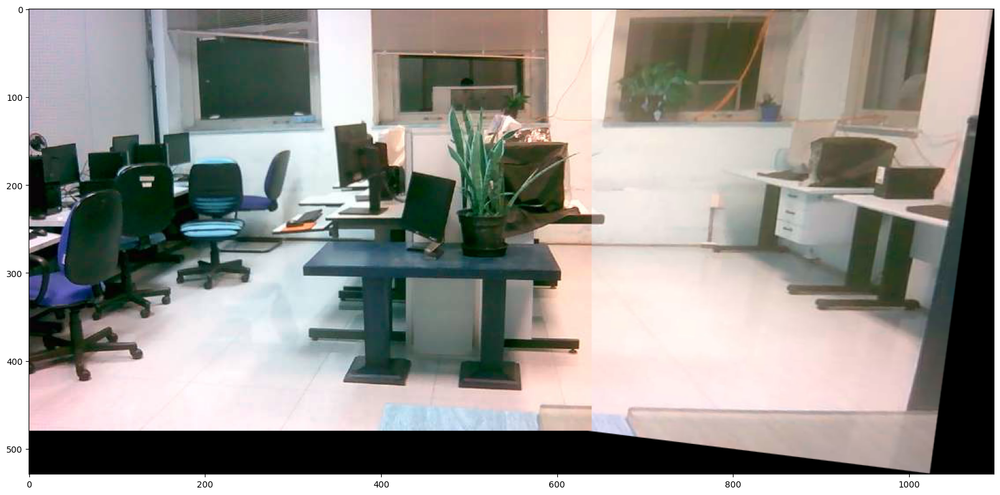

In [ ]:
# transform the panorama image to grayscale and threshold it
gray = cv.cvtColor(result, cv.COLOR_BGR2GRAY)
thresh = cv.threshold(gray, 0, 255, cv.THRESH_BINARY)[1]

# Finds contours from the binary image
cnts = cv.findContours(thresh.copy(), cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)

# get the maximum contour area
c = max(cnts, key=cv.contourArea)

# get a bbox from the contour area
(x, y, w, h) = cv.boundingRect(c)

# crop the image to the bbox coordinates
result = result[y:y + h, x:x + w]
result2 = cv.cvtColor(result, cv.COLOR_BGR2RGB)

img = cv.imwrite('/content/drive/MyDrive/SistemaDualCameras/imgs_virtuais/ImgVirtual02_052.png', result2)


# show the cropped image
plt.figure(figsize=(20,10))
plt.imshow(result2)

### Tentativa 2: Utilizando a equação com os parâmetros de orientação relativa entre as câmeras ( Resultado incorreto )

In [ ]:
import numpy as np
import cv2
from PIL import Image
import math

WidthSensor = 5.9961
Num_col = 640
HeightSensor = 4.5000
Num_lin = 480

TpEx = WidthSensor / float(Num_col)
TpEy = HeightSensor / float(Num_lin)

TpE = (TpEx + TpEy) / 2
#print(TpE)
def gerar_imagem_virtual(imagem_corrigida1, imagem_corrigida2, matriz_rotacao, distancia_focal_referencia, distancia_focal_adjacente,matriz_translacao):
    # Obter as dimensões das imagens corrigidas
    NTL, NTC, _ = imagem_corrigida1.shape
    #print(NTL, NTC)
    NTL2, NTC2, _2 = imagem_corrigida2.shape
    # Criar uma imagem virtual vazia com base nas dimensões das imagens corrigidas
    #imagem_virtual = np.zeros((NTL+NTL2, NTC+NTC2, 3), dtype=np.uint8)

    imagem_virtual = np.zeros((2000, 2000, 3), dtype=np.uint8)

    # Obter os elementos da matriz de rotação
    r11, r12, r13 = matriz_rotacao[0]
    r21, r22, r23 = matriz_rotacao[1]
    r31, r32, r33 = matriz_rotacao[2]

    #Obter os elementos da matriz de translação
    tx = matriz_translacao[0]
    ty = matriz_translacao[1]

    # Percorrer cada pixel da imagem virtual
    for L in range(NTL):
        for C in range(NTC):

            x_c = (C - (NTC - 1)/2) * TpEx
            y_c = - (L - (NTL - 1)/2) * TpEy

            denominador = r31 * (x_c) + r32 * (y_c) - r33 * distancia_focal_adjacente

            # Calcular as coordenadas retificadas no referencial fotogramétrico
            x_n = ((-distancia_focal_referencia * (r11 * (x_c) + r22 * (y_c) - r13 * distancia_focal_adjacente)) / denominador)
            y_n = ((-distancia_focal_referencia * (r21 * (x_c) + r22 * (y_c) - r23 * distancia_focal_adjacente)) / denominador)
            #print(y_c, y_n, x_c, x_n)
            # Verificar se as coordenadas retificadas estão dentro dos limites da imagem corrigida
            #if y_n >= 0 and y_n < NTC and x_n >= 0 and x_n < NTL:
            #print(x_c,float(x_n),y_c,float(y_n))
            C_n = int(((x_n / TpE) + (NTC - 1) / 2))
            L_n = int((-(y_n / TpE) + (NTL - 1) / 2))
            #print(C_n, L_n)

            # Obter o valor do pixel correspondente na imagem corrigida
            pixel_corrigido = imagem_corrigida1[L, C]
            pixel_corrigido2 = imagem_corrigida2[L, C]

            # if C_n < 0:
            #   C_n = 0
            # if L_n < 0:
            #   L_n = 0
            # if L_n >= 640:
            #   L_n = 639
            # if C_n >= 480:
            #   C_n = 479
            #print(C_n, L_n)
            # Atribuir o valor do pixel na imagem virtual
            imagem_virtual[L_n+200, C_n+200] = pixel_corrigido
            #imagem_virtual[L_n+400, C_n+400] = pixel_corrigido2
            imagem_virtual[L+1200, C+400] = pixel_corrigido
            imagem_virtual[L+1200, C+1040] = pixel_corrigido2



    data = Image.fromarray(imagem_virtual)

    # saving the final output
    # as a PNG file
    data.save('img_virtual3.png')

    # Retornar a imagem virtual gerada
    #return imagem_virtual

gerar_imagem_virtual(imgE, imgD, R, fE, fD,T)

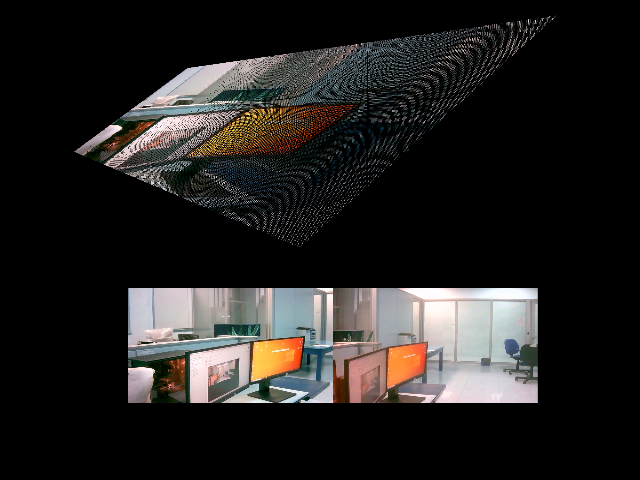

In [ ]:
img = cv.imread('/content/img_virtual3.png')
img_resized = cv.resize(img, (640, 480), cv.INTER_LINEAR)
cv2_imshow(img_resized)

## 5) Estimar os parâmetros de orientação exterior (POEs) de no mínimo 3 imagens virtuais usando fototriangulação por feixes de raios de luz perspectivos (Eq. de colinearidade)

### Obter os pontos homólogos entre as imagens virtuais 1 e 2

In [ ]:
def redimensiona_img(imagem, nova_altura, nova_largura):
  # Calcular o número de linhas e colunas a serem adicionadas
  linhas_adicionais = nova_altura - imagem.shape[0]
  colunas_adicionais = nova_largura - imagem.shape[1]

  # Verificar se é necessário adicionar linhas adicionais
  if linhas_adicionais > 0:
      linhas_superior = linhas_adicionais // 2
      linhas_inferior = linhas_adicionais - linhas_superior
  else:
      linhas_superior = 0
      linhas_inferior = 0

  # Verificar se é necessário adicionar colunas adicionais
  if colunas_adicionais > 0:
      colunas_esquerda = colunas_adicionais // 2
      colunas_direita = colunas_adicionais - colunas_esquerda
  else:
      colunas_esquerda = 0
      colunas_direita = 0

  # Adicionar pixels escuros nas áreas adicionais
  imagem_preenchida = np.pad(imagem, ((linhas_superior, linhas_inferior), (colunas_esquerda, colunas_direita), (0, 0)), mode='constant', constant_values=0)

  return imagem_preenchida

#cv2_imshow(redimensiona_img(trainImg, 540, 1140))

<ipython-input-131-b186931108f4>:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  trainImg = imageio.imread(img_virtualTrain)
<ipython-input-131-b186931108f4>:9: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  queryImg = imageio.imread(img_virtualQuery)


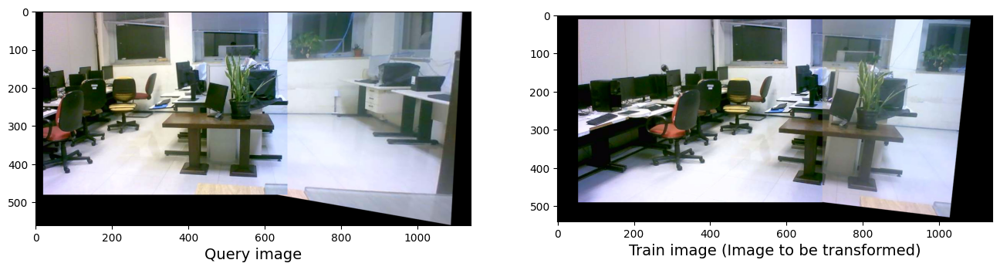

(540, 1140, 3) (560, 1140, 3)


In [ ]:
img_virtualQuery = '/content/drive/MyDrive/SistemaDualCameras/imgs_virtuais/ImgVirtual01_050.png'
img_virtualTrain = '/content/drive/MyDrive/SistemaDualCameras/imgs_virtuais/ImgVirtual02_052.png'
# read images and transform them to grayscale
# Make sure that the train image is the image that will be transformed
trainImg = imageio.imread(img_virtualTrain)
trainImg = redimensiona_img(trainImg, 540, 1140)
trainImg_gray = cv.cvtColor(trainImg, cv.COLOR_RGB2GRAY)

queryImg = imageio.imread(img_virtualQuery)
queryImg = redimensiona_img(queryImg, 540, 1140)
queryImg_gray = cv.cvtColor(queryImg, cv.COLOR_RGB2GRAY)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
ax1.imshow(queryImg, cmap="gray")
ax1.set_xlabel("Query image", fontsize=14)

ax2.imshow(trainImg, cmap="gray")
ax2.set_xlabel("Train image (Image to be transformed)", fontsize=14)

plt.show()
print(trainImg.shape, queryImg.shape)

In [ ]:
kpsA, featuresA = detectAndDescribe(trainImg_gray, method=feature_extractor)
kpsB, featuresB = detectAndDescribe(queryImg_gray, method=feature_extractor)

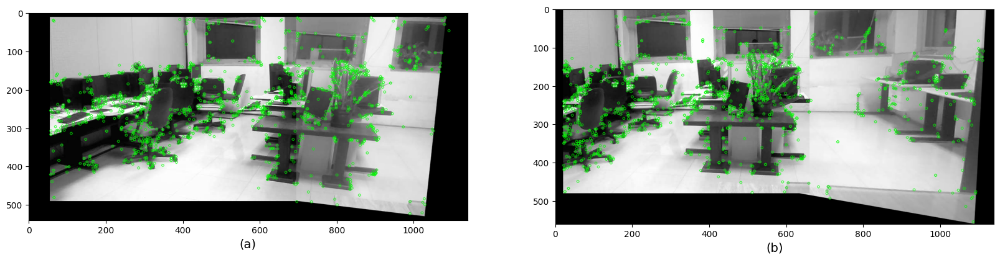

In [ ]:
# display the keypoints and features detected on both images
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
ax1.imshow(cv.drawKeypoints(trainImg_gray,kpsA,None,color=(0,255,0)))
ax1.set_xlabel("(a)", fontsize=14)
ax2.imshow(cv.drawKeypoints(queryImg_gray,kpsB,None,color=(0,255,0)))
ax2.set_xlabel("(b)", fontsize=14)

plt.show()

Using: knn feature matcher
Raw matches (knn): 1460


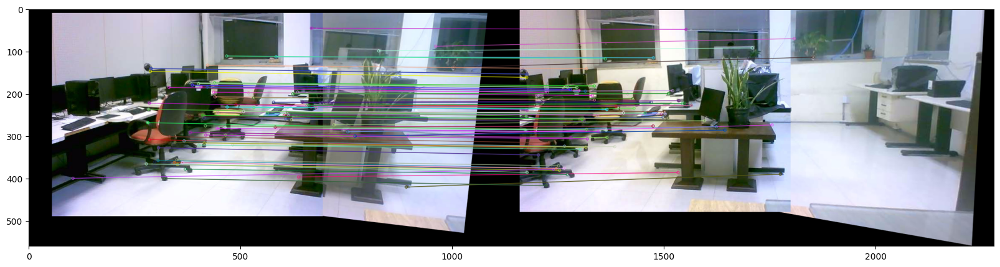

In [ ]:
print("Using: {} feature matcher".format(feature_matching))

fig = plt.figure(figsize=(20,8))

if feature_matching == 'bf':
    matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
    img3 = cv.drawMatches(trainImg,kpsA,queryImg,kpsB,matches[:100],
                           None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
elif feature_matching == 'knn':
    matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.52, method=feature_extractor)
    img3 = cv.drawMatches(trainImg,kpsA,queryImg,kpsB,np.random.choice(matches,100),
                           None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


plt.imshow(img3)
plt.show()

[(104, 400), (278, 366), (281, 269), (283, 237), (285, 223), (285, 309), (287, 148), (288, 333), (289, 141), (291, 214), (292, 366), (292, 353), (293, 245), (295, 345), (295, 333), (297, 361), (298, 327), (301, 237), (303, 350), (305, 279), (306, 358), (306, 377), (306, 328), (308, 265), (310, 331), (312, 189), (315, 310), (315, 149), (316, 286), (320, 224), (320, 401), (321, 187), (327, 391), (330, 346), (331, 185), (332, 302), (335, 336), (340, 313), (342, 159), (344, 363), (345, 315), (348, 360), (348, 364), (350, 356), (351, 367), (353, 146), (356, 351), (361, 149), (364, 363), (366, 345), (367, 312), (370, 378), (372, 170), (379, 253), (381, 174), (381, 292), (386, 163), (386, 180), (397, 333), (398, 191), (398, 140), (401, 176), (401, 187), (402, 322), (404, 191), (407, 184), (410, 251), (411, 288), (414, 324), (414, 258), (414, 317), (417, 276), (418, 298), (420, 130), (421, 137), (421, 185), (422, 133), (427, 313), (431, 301), (437, 197), (437, 144), (439, 175), (440, 249), (44

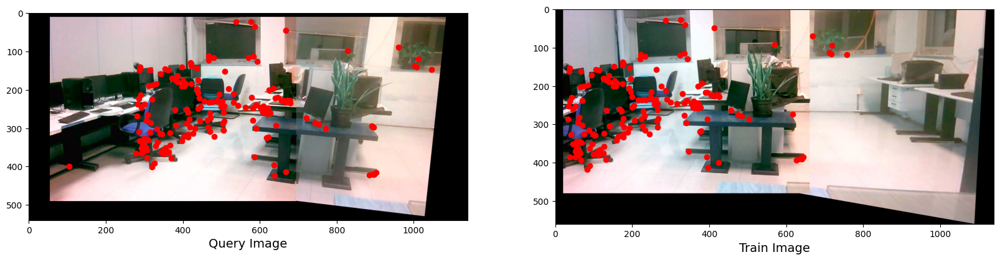

Foram obtidos 174 pontos homólogos entre as imagens


In [ ]:
# Initialize lists
list_kpsA = []
list_kpsB = []

# For each match...
for mat in matches:

    # Get the matching keypoints for each of the images
    imgA_idx = mat.queryIdx
    imgB_idx = mat.trainIdx

    # x - columns
    # y - rows
    # Get the coordinates
    (xA, yA) = kpsA[imgA_idx].pt
    (xB, yB) = kpsB[imgB_idx].pt

    # Append to each list
    list_kpsA.append((xA, yA))
    list_kpsB.append((xB, yB))

list_kpsA = [(round(list_kpsA_unit[0]),round(list_kpsA_unit[1])) for list_kpsA_unit in list_kpsA]
list_kpsB = [(round(list_kpsB_unit[0]),round(list_kpsB_unit[1])) for list_kpsB_unit in list_kpsB]

list_kpsA = [x for i, x in enumerate(list_kpsA) if x not in list_kpsA[:i]]
list_kpsB = [x for i, x in enumerate(list_kpsB) if x not in list_kpsB[:i]]

print(list_kpsA,'\n', list_kpsB)
array_kpsA = np.array(list_kpsA)
array_kpsB = np.array(list_kpsB)
imgA = trainImg
#imgA = cv.imread(img_virtualQuery)
imgB = queryImg
#imgB = cv.imread(img_virtualTrain)

# display the keypoints and features detected on both images
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)

ax1.imshow(imgA[:,:,[2,1,0]])
ax1.scatter(array_kpsA[:,0], array_kpsA[:,1], color='red')
ax1.set_xlabel("Query Image", fontsize=14)
#ax1.axis('off')

ax2.imshow(imgB[:,:,[2,1,0]])
ax2.scatter(array_kpsB[:,0], array_kpsB[:,1], color='red')
ax2.set_xlabel("Train Image", fontsize=14)
#ax2.axis('off')

plt.show()

print(f'Foram obtidos {len(array_kpsA)} pontos homólogos entre as imagens')

In [ ]:
# Pontos homólogos entre a ImgV1 e a ImgV2
lista_ptos12_ImgVirtual01 = list_kpsA
lista_ptos12_ImgVirtual02 = list_kpsB

In [ ]:
print(lista_ptos12_ImgVirtual01, '\n', lista_ptos12_ImgVirtual02)

[(104, 400), (278, 366), (281, 269), (283, 237), (285, 223), (285, 309), (287, 148), (288, 333), (289, 141), (291, 214), (292, 366), (292, 353), (293, 245), (295, 345), (295, 333), (297, 361), (298, 327), (301, 237), (303, 350), (305, 279), (306, 358), (306, 377), (306, 328), (308, 265), (310, 331), (312, 189), (315, 310), (315, 149), (316, 286), (320, 224), (320, 401), (321, 187), (327, 391), (330, 346), (331, 185), (332, 302), (335, 336), (340, 313), (342, 159), (344, 363), (345, 315), (348, 360), (348, 364), (350, 356), (351, 367), (353, 146), (356, 351), (361, 149), (364, 363), (366, 345), (367, 312), (370, 378), (372, 170), (379, 253), (381, 174), (381, 292), (386, 163), (386, 180), (397, 333), (398, 191), (398, 140), (401, 176), (401, 187), (402, 322), (404, 191), (407, 184), (410, 251), (411, 288), (414, 324), (414, 258), (414, 317), (417, 276), (418, 298), (420, 130), (421, 137), (421, 185), (422, 133), (427, 313), (431, 301), (437, 197), (437, 144), (439, 175), (440, 249), (44

### Obter os pontos homólogos entre as imagens virtuais 2 e 3

In [ ]:
def redimensiona_img(imagem, nova_altura, nova_largura):
  # Calcular o número de linhas e colunas a serem adicionadas
  linhas_adicionais = nova_altura - imagem.shape[0]
  colunas_adicionais = nova_largura - imagem.shape[1]

  # Verificar se é necessário adicionar linhas adicionais
  if linhas_adicionais > 0:
      linhas_superior = linhas_adicionais // 2
      linhas_inferior = linhas_adicionais - linhas_superior
  else:
      linhas_superior = 0
      linhas_inferior = 0

  # Verificar se é necessário adicionar colunas adicionais
  if colunas_adicionais > 0:
      colunas_esquerda = colunas_adicionais // 2
      colunas_direita = colunas_adicionais - colunas_esquerda
  else:
      colunas_esquerda = 0
      colunas_direita = 0

  # Adicionar pixels escuros nas áreas adicionais
  imagem_preenchida = np.pad(imagem, ((linhas_superior, linhas_inferior), (colunas_esquerda, colunas_direita), (0, 0)), mode='constant', constant_values=0)

  return imagem_preenchida

#cv2_imshow(redimensiona_img(trainImg, 540, 1140))

<ipython-input-547-d2d41e42a51e>:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  trainImg = imageio.imread(img_virtualTrain)
<ipython-input-547-d2d41e42a51e>:9: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  queryImg = imageio.imread(img_virtualQuery)


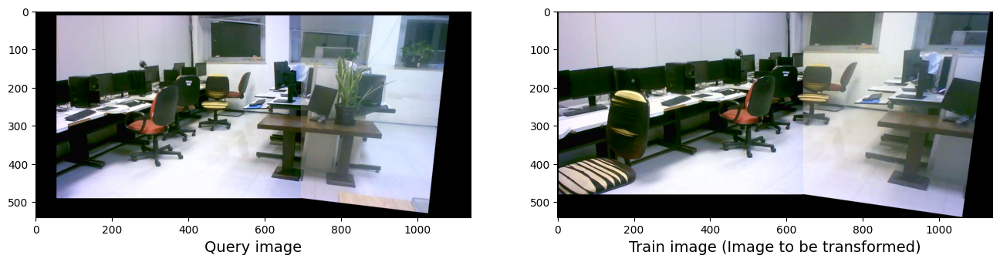

(540, 1140, 3) (540, 1140, 3)


In [ ]:
img_virtualQuery = '/content/drive/MyDrive/SistemaDualCameras/imgs_virtuais/ImgVirtual02_052.png'
img_virtualTrain = '/content/drive/MyDrive/SistemaDualCameras/imgs_virtuais/ImgVirtual03_050.png'
# read images and transform them to grayscale
# Make sure that the train image is the image that will be transformed
trainImg = imageio.imread(img_virtualTrain)
trainImg = redimensiona_img(trainImg, 540, 1140)
trainImg_gray = cv.cvtColor(trainImg, cv.COLOR_RGB2GRAY)

queryImg = imageio.imread(img_virtualQuery)
queryImg = redimensiona_img(queryImg, 540, 1140)
queryImg_gray = cv.cvtColor(queryImg, cv.COLOR_RGB2GRAY)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
ax1.imshow(queryImg, cmap="gray")
ax1.set_xlabel("Query image", fontsize=14)

ax2.imshow(trainImg, cmap="gray")
ax2.set_xlabel("Train image (Image to be transformed)", fontsize=14)

plt.show()
print(trainImg.shape, queryImg.shape)

In [ ]:
kpsA, featuresA = detectAndDescribe(trainImg_gray, method=feature_extractor)
kpsB, featuresB = detectAndDescribe(queryImg_gray, method=feature_extractor)

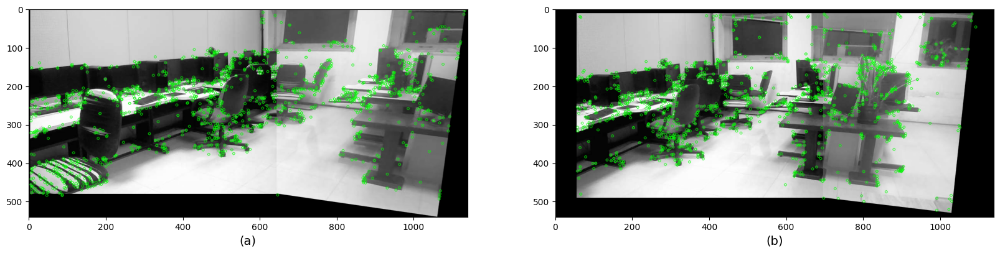

In [ ]:
# display the keypoints and features detected on both images
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
ax1.imshow(cv.drawKeypoints(trainImg_gray,kpsA,None,color=(0,255,0)))
ax1.set_xlabel("(a)", fontsize=14)
ax2.imshow(cv.drawKeypoints(queryImg_gray,kpsB,None,color=(0,255,0)))
ax2.set_xlabel("(b)", fontsize=14)

plt.show()

Using: knn feature matcher
Raw matches (knn): 1472


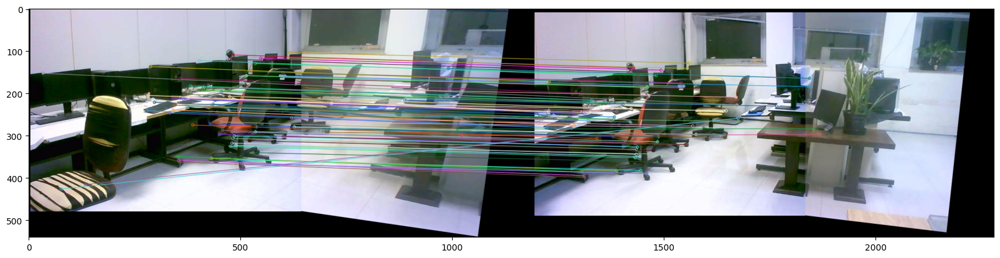

In [ ]:
print("Using: {} feature matcher".format(feature_matching))

fig = plt.figure(figsize=(20,8))

if feature_matching == 'bf':
    matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
    img3 = cv.drawMatches(trainImg,kpsA,queryImg,kpsB,matches[:100],
                           None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
elif feature_matching == 'knn':
    matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.52, method=feature_extractor)
    img3 = cv.drawMatches(trainImg,kpsA,queryImg,kpsB,np.random.choice(matches,100),
                           None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


plt.imshow(img3)
plt.show()

[(34, 153), (77, 426), (105, 402), (121, 440), (133, 416), (272, 219), (276, 267), (279, 242), (282, 206), (285, 359), (287, 266), (287, 138), (294, 214), (297, 222), (328, 341), (333, 247), (336, 292), (338, 212), (339, 246), (341, 240), (345, 228), (347, 356), (351, 367), (351, 350), (354, 359), (354, 231), (357, 363), (357, 165), (358, 213), (365, 215), (369, 239), (371, 203), (372, 234), (374, 210), (374, 231), (377, 212), (378, 236), (379, 207), (382, 183), (384, 206), (384, 248), (385, 202), (387, 275), (390, 186), (392, 203), (392, 193), (403, 124), (405, 194), (410, 183), (411, 244), (412, 243), (413, 186), (418, 191), (425, 237), (427, 184), (428, 273), (428, 176), (429, 219), (430, 360), (432, 354), (432, 355), (432, 231), (436, 226), (441, 287), (441, 213), (441, 185), (441, 358), (445, 245), (450, 154), (451, 297), (455, 268), (455, 197), (457, 288), (463, 335), (464, 277), (464, 193), (468, 191), (468, 208), (470, 334), (470, 243), (472, 297), (472, 240), (474, 120), (474,

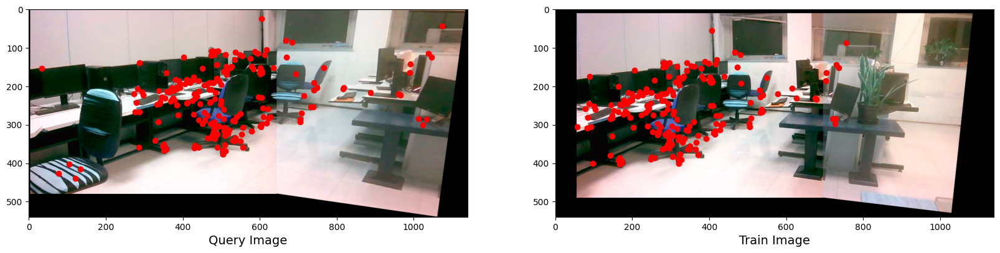

Foram obtidos 197 pontos homólogos entre as imagens


In [ ]:
# Initialize lists
list_kpsA = []
list_kpsB = []

# For each match...
for mat in matches:

    # Get the matching keypoints for each of the images
    imgA_idx = mat.queryIdx
    imgB_idx = mat.trainIdx

    # x - columns
    # y - rows
    # Get the coordinates
    (xA, yA) = kpsA[imgA_idx].pt
    (xB, yB) = kpsB[imgB_idx].pt

    # Append to each list
    list_kpsA.append((xA, yA))
    list_kpsB.append((xB, yB))

list_kpsA = [(round(list_kpsA_unit[0]),round(list_kpsA_unit[1])) for list_kpsA_unit in list_kpsA]
list_kpsB = [(round(list_kpsB_unit[0]),round(list_kpsB_unit[1])) for list_kpsB_unit in list_kpsB]

list_kpsA = [x for i, x in enumerate(list_kpsA) if x not in list_kpsA[:i]]
list_kpsB = [x for i, x in enumerate(list_kpsB) if x not in list_kpsB[:i]]

print(list_kpsA,'\n', list_kpsB)
array_kpsA = np.array(list_kpsA)
array_kpsB = np.array(list_kpsB)
imgA = trainImg
#imgA = cv.imread(img_virtualQuery)
imgB = queryImg
#imgB = cv.imread(img_virtualTrain)

# display the keypoints and features detected on both images
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)

ax1.imshow(imgA[:,:,[2,1,0]])
ax1.scatter(array_kpsA[:,0], array_kpsA[:,1], color='red')
ax1.set_xlabel("Query Image", fontsize=14)
#ax1.axis('off')

ax2.imshow(imgB[:,:,[2,1,0]])
ax2.scatter(array_kpsB[:,0], array_kpsB[:,1], color='red')
ax2.set_xlabel("Train Image", fontsize=14)
#ax2.axis('off')

plt.show()

print(f'Foram obtidos {len(array_kpsA)} pontos homólogos entre as imagens')

In [ ]:
# Pontos homólogos entre a ImgV2 e a ImgV3
lista_ptos23_ImgVirtual02 = list_kpsA
lista_ptos23_ImgVirtual03 = list_kpsB

In [ ]:
print(lista_ptos23_ImgVirtual02, '\n', lista_ptos23_ImgVirtual03)

[(34, 153), (77, 426), (105, 402), (121, 440), (133, 416), (272, 219), (276, 267), (279, 242), (282, 206), (285, 359), (287, 266), (287, 138), (294, 214), (297, 222), (328, 341), (333, 247), (336, 292), (338, 212), (339, 246), (341, 240), (345, 228), (347, 356), (351, 367), (351, 350), (354, 359), (354, 231), (357, 363), (357, 165), (358, 213), (365, 215), (369, 239), (371, 203), (372, 234), (374, 210), (374, 231), (377, 212), (378, 236), (379, 207), (382, 183), (384, 206), (384, 248), (385, 202), (387, 275), (390, 186), (392, 203), (392, 193), (403, 124), (405, 194), (410, 183), (411, 244), (412, 243), (413, 186), (418, 191), (425, 237), (427, 184), (428, 273), (428, 176), (429, 219), (430, 360), (432, 354), (432, 355), (432, 231), (436, 226), (441, 287), (441, 213), (441, 185), (441, 358), (445, 245), (450, 154), (451, 297), (455, 268), (455, 197), (457, 288), (463, 335), (464, 277), (464, 193), (468, 191), (468, 208), (470, 334), (470, 243), (472, 297), (472, 240), (474, 120), (474,

### Obter os pontos homólogos entre as imagens virtuais 3 e 1

In [ ]:
def redimensiona_img(imagem, nova_altura, nova_largura):
  # Calcular o número de linhas e colunas a serem adicionadas
  linhas_adicionais = nova_altura - imagem.shape[0]
  colunas_adicionais = nova_largura - imagem.shape[1]

  # Verificar se é necessário adicionar linhas adicionais
  if linhas_adicionais > 0:
      linhas_superior = linhas_adicionais // 2
      linhas_inferior = linhas_adicionais - linhas_superior
  else:
      linhas_superior = 0
      linhas_inferior = 0

  # Verificar se é necessário adicionar colunas adicionais
  if colunas_adicionais > 0:
      colunas_esquerda = colunas_adicionais // 2
      colunas_direita = colunas_adicionais - colunas_esquerda
  else:
      colunas_esquerda = 0
      colunas_direita = 0

  # Adicionar pixels escuros nas áreas adicionais
  imagem_preenchida = np.pad(imagem, ((linhas_superior, linhas_inferior), (colunas_esquerda, colunas_direita), (0, 0)), mode='constant', constant_values=0)

  return imagem_preenchida

#cv2_imshow(redimensiona_img(trainImg, 540, 1140))

<ipython-input-122-3c2a6f8176d8>:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  trainImg = imageio.imread(img_virtualTrain)
<ipython-input-122-3c2a6f8176d8>:9: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  queryImg = imageio.imread(img_virtualQuery)


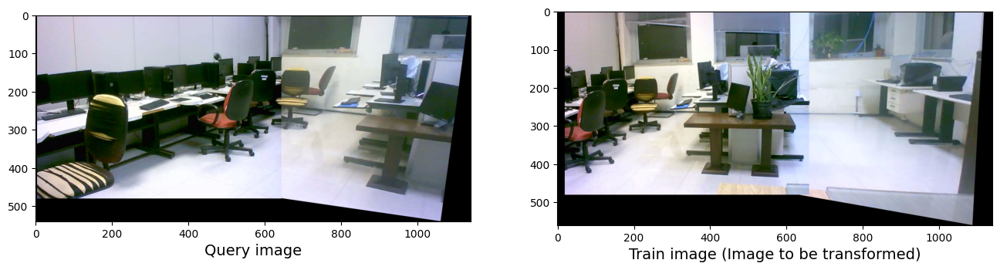

(560, 1140, 3) (540, 1140, 3)


In [ ]:
img_virtualQuery = '/content/drive/MyDrive/SistemaDualCameras/imgs_virtuais/ImgVirtual03_050.png'
img_virtualTrain = '/content/drive/MyDrive/SistemaDualCameras/imgs_virtuais/ImgVirtual01_050.png'
# read images and transform them to grayscale
# Make sure that the train image is the image that will be transformed
trainImg = imageio.imread(img_virtualTrain)
trainImg = redimensiona_img(trainImg, 540, 1140)
trainImg_gray = cv.cvtColor(trainImg, cv.COLOR_RGB2GRAY)

queryImg = imageio.imread(img_virtualQuery)
queryImg = redimensiona_img(queryImg, 540, 1140)
queryImg_gray = cv.cvtColor(queryImg, cv.COLOR_RGB2GRAY)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
ax1.imshow(queryImg, cmap="gray")
ax1.set_xlabel("Query image", fontsize=14)

ax2.imshow(trainImg, cmap="gray")
ax2.set_xlabel("Train image (Image to be transformed)", fontsize=14)

plt.show()
print(trainImg.shape, queryImg.shape)

In [ ]:
kpsA, featuresA = detectAndDescribe(trainImg_gray, method=feature_extractor)
kpsB, featuresB = detectAndDescribe(queryImg_gray, method=feature_extractor)

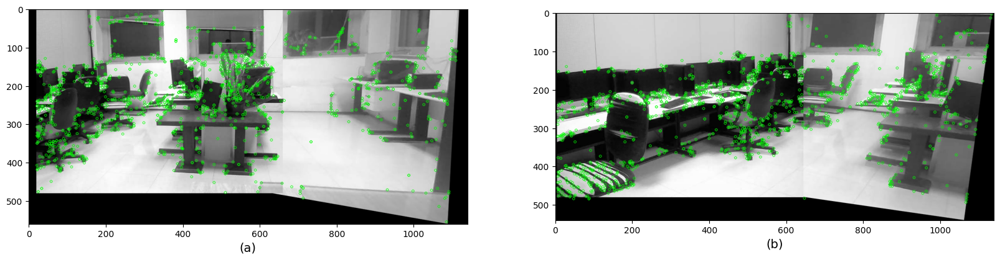

In [ ]:
# display the keypoints and features detected on both images
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
ax1.imshow(cv.drawKeypoints(trainImg_gray,kpsA,None,color=(0,255,0)))
ax1.set_xlabel("(a)", fontsize=14)
ax2.imshow(cv.drawKeypoints(queryImg_gray,kpsB,None,color=(0,255,0)))
ax2.set_xlabel("(b)", fontsize=14)

plt.show()

Using: knn feature matcher
Raw matches (knn): 1440


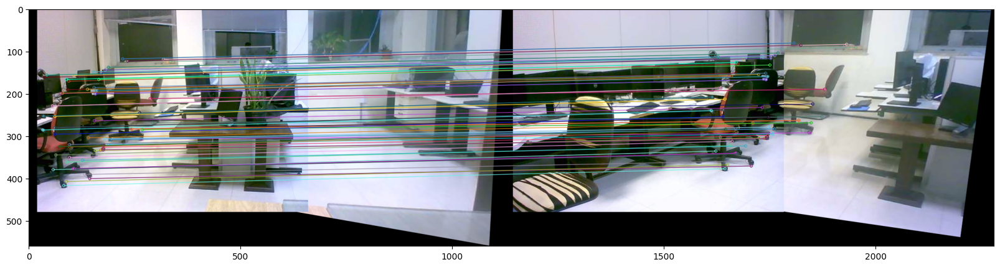

In [ ]:
print("Using: {} feature matcher".format(feature_matching))

fig = plt.figure(figsize=(20,8))

if feature_matching == 'bf':
    matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
    img3 = cv.drawMatches(trainImg,kpsA,queryImg,kpsB,matches[:100],
                           None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
elif feature_matching == 'knn':
    matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.52, method=feature_extractor)
    img3 = cv.drawMatches(trainImg,kpsA,queryImg,kpsB,np.random.choice(matches,100),
                           None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)


plt.imshow(img3)
plt.show()

[(33, 165), (33, 286), (35, 253), (35, 157), (36, 162), (42, 156), (51, 297), (53, 351), (54, 355), (55, 345), (56, 229), (58, 380), (59, 289), (61, 281), (62, 296), (62, 254), (64, 345), (69, 302), (74, 325), (75, 200), (80, 199), (83, 417), (89, 408), (89, 167), (89, 362), (91, 191), (94, 171), (96, 320), (96, 351), (97, 326), (106, 377), (106, 157), (111, 378), (113, 159), (125, 376), (127, 357), (132, 391), (139, 190), (141, 304), (141, 383), (144, 401), (153, 149), (154, 186), (154, 197), (155, 264), (157, 201), (157, 335), (160, 193), (165, 167), (166, 330), (167, 260), (170, 333), (171, 151), (175, 138), (176, 333), (176, 327), (177, 285), (179, 307), (180, 145), (188, 321), (188, 138), (192, 309), (222, 118), (234, 123), (242, 284), (257, 274), (262, 246), (266, 308), (268, 285), (273, 298), (287, 212), (292, 270), (292, 269), (305, 218), (318, 119), (324, 120), (335, 124)] 
 [(477, 121), (472, 240), (474, 208), (481, 113), (481, 118), (489, 113), (491, 252), (482, 307), (482, 

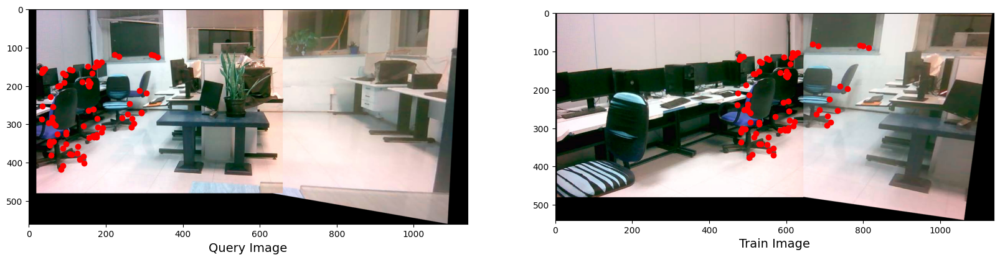

Foram obtidos 77 pontos homólogos entre as imagens


In [ ]:
# Initialize lists
list_kpsA = []
list_kpsB = []

# For each match...
for mat in matches:

    # Get the matching keypoints for each of the images
    imgA_idx = mat.queryIdx
    imgB_idx = mat.trainIdx

    # x - columns
    # y - rows
    # Get the coordinates
    (xA, yA) = kpsA[imgA_idx].pt
    (xB, yB) = kpsB[imgB_idx].pt

    # Append to each list
    list_kpsA.append((xA, yA))
    list_kpsB.append((xB, yB))

list_kpsA = [(round(list_kpsA_unit[0]),round(list_kpsA_unit[1])) for list_kpsA_unit in list_kpsA]
list_kpsB = [(round(list_kpsB_unit[0]),round(list_kpsB_unit[1])) for list_kpsB_unit in list_kpsB]

list_kpsA = [x for i, x in enumerate(list_kpsA) if x not in list_kpsA[:i]]
list_kpsB = [x for i, x in enumerate(list_kpsB) if x not in list_kpsB[:i]]

print(list_kpsA,'\n', list_kpsB)
array_kpsA = np.array(list_kpsA)
array_kpsB = np.array(list_kpsB)
imgA = trainImg
#imgA = cv.imread(img_virtualQuery)
imgB = queryImg
#imgB = cv.imread(img_virtualTrain)

# display the keypoints and features detected on both images
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)

ax1.imshow(imgA[:,:,[2,1,0]])
ax1.scatter(array_kpsA[:,0], array_kpsA[:,1], color='red')
ax1.set_xlabel("Query Image", fontsize=14)
#ax1.axis('off')

ax2.imshow(imgB[:,:,[2,1,0]])
ax2.scatter(array_kpsB[:,0], array_kpsB[:,1], color='red')
ax2.set_xlabel("Train Image", fontsize=14)
#ax2.axis('off')

plt.show()

print(f'Foram obtidos {len(array_kpsA)} pontos homólogos entre as imagens')

In [ ]:
# Pontos homólogos entre a ImgV3 e a ImgV1
lista_ptos31_ImgVirtual03 = list_kpsA
lista_ptos31_ImgVirtual01 = list_kpsB

In [ ]:
print(lista_ptos31_ImgVirtual03, '\n', lista_ptos31_ImgVirtual01)

[(33, 165), (33, 286), (35, 253), (35, 157), (36, 162), (42, 156), (51, 297), (53, 351), (54, 355), (55, 345), (56, 229), (58, 380), (59, 289), (61, 281), (62, 296), (62, 254), (64, 345), (69, 302), (74, 325), (75, 200), (80, 199), (83, 417), (89, 408), (89, 167), (89, 362), (91, 191), (94, 171), (96, 320), (96, 351), (97, 326), (106, 377), (106, 157), (111, 378), (113, 159), (125, 376), (127, 357), (132, 391), (139, 190), (141, 304), (141, 383), (144, 401), (153, 149), (154, 186), (154, 197), (155, 264), (157, 201), (157, 335), (160, 193), (165, 167), (166, 330), (167, 260), (170, 333), (171, 151), (175, 138), (176, 333), (176, 327), (177, 285), (179, 307), (180, 145), (188, 321), (188, 138), (192, 309), (222, 118), (234, 123), (242, 284), (257, 274), (262, 246), (266, 308), (268, 285), (273, 298), (287, 212), (292, 270), (292, 269), (305, 218), (318, 119), (324, 120), (335, 124)] 
 [(477, 121), (472, 240), (474, 208), (481, 113), (481, 118), (489, 113), (491, 252), (482, 307), (482, 

### Obter os pontos homólogos entre as três imagens

In [ ]:
# Criando uma função para analisar como o input 4 listas, onde vai percorrer a primeira, verificar se há esse termo
# na terceira lista, e coletar esse elemento e os elementos correspondentes nas outras 2 listas para coletar os pontos
# que pertencem às três imagens. A primeira e a terceira lista pertencem a primeira imagem virtual, a segunda lista pertence
# a segunda imagem virtual e a quarta lista pertence à terceira imagem virtual

def coordCorresp3Img (lista1, lista2, lista3, lista4):
  coordImg1 = []
  coordImg2 = []
  coordImg3 = []
  for indice, elemento in enumerate(lista1):
    if elemento in lista3:
      print('alguma coisa')
      # Encontrando o índice do elemento na lista 4:
      ind = lista4.index(elemento)

      # Podemos então adicionar os termos nas listas correspondentes:
      coordImg1.append(elemento)
      coordImg2.append(lista2[indice])
      coordImg3.append(lista4[ind])

  return coordImg1, coordImg2, coordImg3

coordCorresp3Img(lista_ptos12_ImgVirtual01, lista_ptos12_ImgVirtual02, lista_ptos31_ImgVirtual01, lista_ptos31_ImgVirtual03)

([], [], [])

In [ ]:
print(lista_ptos12_ImgVirtual01, '\n', lista_ptos31_ImgVirtual01)

[(104, 400), (278, 366), (281, 269), (283, 237), (285, 223), (285, 309), (287, 148), (288, 333), (289, 141), (291, 214), (292, 366), (292, 353), (293, 245), (295, 345), (295, 333), (297, 361), (298, 327), (301, 237), (303, 350), (305, 279), (306, 358), (306, 377), (306, 328), (308, 265), (310, 331), (312, 189), (315, 310), (315, 149), (316, 286), (320, 224), (320, 401), (321, 187), (327, 391), (330, 346), (331, 185), (332, 302), (335, 336), (340, 313), (342, 159), (344, 363), (345, 315), (348, 360), (348, 364), (350, 356), (351, 367), (353, 146), (356, 351), (361, 149), (364, 363), (366, 345), (367, 312), (370, 378), (372, 170), (379, 253), (381, 174), (381, 292), (386, 163), (386, 180), (397, 333), (398, 191), (398, 140), (401, 176), (401, 187), (402, 322), (404, 191), (407, 184), (410, 251), (411, 288), (414, 324), (414, 258), (414, 317), (417, 276), (418, 298), (420, 130), (421, 137), (421, 185), (422, 133), (427, 313), (431, 301), (437, 197), (437, 144), (439, 175), (440, 249), (44

#### Formando o vetor Lb das observações

In [ ]:
# Para tal será criado uma função que vai percorrer e adicionar a lista os pontos
# formando o vetor das observações que terá como input as 4 listas

def formarLb (lista1, lista2, lista3, lista4):

  Lb = []

  len1 = len(lista1)
  len2 = len(lista2)
  len3 = len(lista3)
  len4 = len(lista4)

  for i in range(len1):
    Lb.append(lista1[i][0])
    Lb.append(lista1[i][1])

  for i in range(len2):
    Lb.append(lista2[i][0])
    Lb.append(lista2[i][1])

  for i in range(len3):
    Lb.append(lista3[i][0])
    Lb.append(lista3[i][1])

  for i in range(len4):
    Lb.append(lista4[i][0])
    Lb.append(lista4[i][1])

  return np.array(Lb)

### Definindo as funções para montar a Jacobiana do ajustamento

In [ ]:
# Começando a escrever as derivadas parciais em relação a cada variável, temos:
import math

def matrixR (k, p, w):
  R_k = np.array([[math.cos(k), math.sin(k), 0], [-math.sin(k), math.cos(k), 0], [0, 0, 1]])
  R_p = np.array([[math.cos(p), 0, -math.sin(p)], [0, 1, 0], [math.sin(p), 0, math.cos(p)]])
  R_w = np.array([[1, 0, 0], [0, math.cos(w), math.sin(w)], [0, -math.sin(w), math.cos(w)]])
  return R_k @ R_p @ R_w


def derivadaFxX (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (R[0, 0] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) - R[2, 0] * (R[0, 0] * (X-X0) + R[0, 1] * (Y-Y0) + R[0, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFxY (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (R[0, 1] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) - R[2, 1] * (R[0, 0] * (X-X0) + R[0, 1] * (Y-Y0) + R[0, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFxZ (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (R[0, 2] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) - R[2, 2] * (R[0, 0] * (X-X0) + R[0, 1] * (Y-Y0) + R[0, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFyX (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (R[1, 0] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) - R[2, 0] * (R[1, 0] * (X-X0) + R[1, 1] * (Y-Y0) + R[1, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFyY (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (R[1, 1] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) - R[2, 1] * (R[1, 0] * (X-X0) + R[1, 1] * (Y-Y0) + R[1, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFyZ (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (R[1, 2] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) - R[2, 2] * (R[1, 0] * (X-X0) + R[1, 1] * (Y-Y0) + R[1, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFxX0 (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (-R[0, 0] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) + R[2, 0] * (R[0, 0] * (X-X0) + R[0, 1] * (Y-Y0) + R[0, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFxY0 (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (-R[0, 1] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) + R[2, 1] * (R[0, 0] * (X-X0) + R[0, 1] * (Y-Y0) + R[0, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFxZ0 (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (-R[0, 2] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) + R[2, 2] * (R[0, 0] * (X-X0) + R[0, 1] * (Y-Y0) + R[0, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFyX0 (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (-R[1, 0] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) + R[2, 0] * (R[1, 0] * (X-X0) + R[1, 1] * (Y-Y0) + R[1, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFyY0 (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (-R[1, 1] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) + R[2, 1] * (R[1, 0] * (X-X0) + R[1, 1] * (Y-Y0) + R[1, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFyZ0 (R, X, X0, Y, Y0, Z, Z0, f):
  derivada = -f * (-R[1, 2] * (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) + R[2, 2] * (R[1, 0] * (X-X0) + R[1, 1] * (Y-Y0) + R[1, 2] * (Z-Z0))) / (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0)) ** 2
  return derivada

def derivadaFxW (w, p, k, X, X0, Y, Y0, Z, Z0, f):
  R = matrixR(k, p, w)
  g =  (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0))
  func = -f * (R[0, 0] * (X-X0) + R[0, 1] * (Y-Y0) + R[0, 2] * (Z-Z0))
  R_rot = matrixR(k, p, w + math.pi/2)
  g_linha = (R_rot[2, 0] * (X-X0) + R_rot[2, 1] * (Y-Y0) + R_rot[2, 2] * (Z-Z0))
  func_linha = -f * (R_rot[0, 0] * (X-X0) + R_rot[0, 1] * (Y-Y0) + R_rot[0, 2] * (Z-Z0))
  derivada = (func_linha * g - func * g_linha) / g ** 2
  return derivada

def derivadaFxPHI (w, p, k, X, X0, Y, Y0, Z, Z0, f):
  R = matrixR(k, p, w)
  g = (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0))
  func = -f * (R[0, 0] * (X-X0) + R[0, 1] * (Y-Y0) + R[0, 2] * (Z-Z0))
  R_rot = matrixR(k, p + math.pi/2, w)
  g_linha = (R_rot[2, 0] * (X-X0) + R_rot[2, 1] * (Y-Y0) + R_rot[2, 2] * (Z-Z0))
  func_linha = -f * (R_rot[0, 0] * (X-X0) + R_rot[0, 1] * (Y-Y0) + R_rot[0, 2] * (Z-Z0))
  derivada = (func_linha * g - func * g_linha) / g ** 2
  return derivada

def derivadaFxKappa (w, p, k, X, X0, Y, Y0, Z, Z0, f):
  R = matrixR(k, p, w)
  g = (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0))
  func = -f * (R[0, 0] * (X-X0) + R[0, 1] * (Y-Y0) + R[0, 2] * (Z-Z0))
  R_rot = matrixR(k + math.pi/2, p, w)
  g_linha = (R_rot[2, 0] * (X-X0) + R_rot[2, 1] * (Y-Y0) + R_rot[2, 2] * (Z-Z0))
  func_linha = -f * (R_rot[0, 0] * (X-X0) + R_rot[0, 1] * (Y-Y0) + R_rot[0, 2] * (Z-Z0))
  derivada = (func_linha * g - func * g_linha) / g ** 2
  return derivada

def derivadaFyW (w, p, k, X, X0, Y, Y0, Z, Z0, f):
  R = matrixR(k, p, w)
  g =  (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0))
  func = -f * (R[1, 0] * (X-X0) + R[1, 1] * (Y-Y0) + R[1, 2] * (Z-Z0))
  R_rot = matrixR(k, p, w + math.pi/2)
  g_linha = (R_rot[2, 0] * (X-X0) + R_rot[2, 1] * (Y-Y0) + R_rot[2, 2] * (Z-Z0))
  func_linha = -f * (R_rot[1, 0] * (X-X0) + R_rot[1, 1] * (Y-Y0) + R_rot[1, 2] * (Z-Z0))
  derivada = (func_linha * g - func * g_linha) / g ** 2
  return derivada

def derivadaFyPHI (w, p, k, X, X0, Y, Y0, Z, Z0, f):
  R = matrixR(k, p, w)
  g = (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0))
  func = -f * (R[1, 0] * (X-X0) + R[1, 1] * (Y-Y0) + R[1, 2] * (Z-Z0))
  R_rot = matrixR(k, p + math.pi/2, w)
  g_linha = (R_rot[2, 0] * (X-X0) + R_rot[2, 1] * (Y-Y0) + R_rot[2, 2] * (Z-Z0))
  func_linha = -f * (R_rot[1, 0] * (X-X0) + R_rot[1, 1] * (Y-Y0) + R_rot[1, 2] * (Z-Z0))
  derivada = (func_linha * g - func * g_linha) / g ** 2
  return derivada

def derivadaFyKappa (w, p, k, X, X0, Y, Y0, Z, Z0, f):
  R = matrixR(k, p, w)
  g = (R[2, 0] * (X-X0) + R[2, 1] * (Y-Y0) + R[2, 2] * (Z-Z0))
  func = -f * (R[1, 0] * (X-X0) + R[1, 1] * (Y-Y0) + R[1, 2] * (Z-Z0))
  R_rot = matrixR(k + math.pi/2, p, w)
  g_linha = (R_rot[2, 0] * (X-X0) + R_rot[2, 1] * (Y-Y0) + R_rot[2, 2] * (Z-Z0))
  func_linha = -f * (R_rot[1, 0] * (X-X0) + R_rot[1, 1] * (Y-Y0) + R_rot[1, 2] * (Z-Z0))
  derivada = (func_linha * g - func * g_linha) / g ** 2
  return derivada

### Cálculo da Jacobiana

In [ ]:
def jacobParam (numObs, qtdPontos12, qtdPontos13, X0):
  # A função possui como parâmetros o número de observações, a quantidade de pontos do terreno que foram coletados,
  # ou seja, pontos diferentes
  # e por fim, o vetor dos parâmetros para que seja calculada a matriz jacobiana dos parâmetros.
  # O número de observações vai dimensionar a quantidade de linhas da matriz
  # jacobiana dos parâmetros, enquanto que o número de parâmetros irá dimensionar
  # a quantidade de colunas.
  # Como será trabalhado com três imagens, teremos X0, Y0, Z0, w, phi, kappa paara cada imagem, logo 18 paramêtros
  # o total da quantida de parâmetros será obtida somando com a quantidade de pontos X, Y, Z
  numPar = 18 + 3 * qtdPontos12 + 3 * qtdPontos13

  # Definindo os parâmetros de acordo com o vetor que representa os parâmetros
  # Para os ângulos de rotação e as coordenadas do centro perspectivo
  w1 = X0[0]
  p1 = X0[1]
  k1 = X0[2]
  w2 = X0[3]
  p2 = X0[4]
  k2 = X0[5]
  w3 = X0[6]
  p3 = X0[7]
  k3 = X0[8]
  X01 = X0[9]
  Y01 = X0[10]
  Z01 = X0[11]
  X02 = X0[12]
  Y02 = X0[13]
  Z02 = X0[14]
  X03 = X0[15]
  Y03 = X0[16]
  Z03 = X0[17]

  # Criando as listas que irão receber os pontos 3D que estão localizados na imagem 1 e 2
  X12 = np.array([X0[i] for i in range(18, 3 * qtdPontos12 + 18, 3)])
  Y12 = np.array([X0[i] for i in range(19, 3 * qtdPontos12 + 19, 3)])
  Z12 = np.array([X0[i] for i in range(20, 3 * qtdPontos12 + 20, 3)])

  # Criando as listas que irão receber os pontos 3D que estão localizdos na imagem 1 e 3
  X13 = np.array([X0[i] for i in range(18 + 3 * qtdPontos12, 18 + 3 * qtdPontos12 + 3 * qtdPontos13, 3)])
  Y13 = np.array([X0[i] for i in range(19 + 3 * qtdPontos12, 19 + 3 * qtdPontos12 + 3 * qtdPontos13, 3)])
  Z13 = np.array([X0[i] for i in range(20 + 3 * qtdPontos12, 20 + 3 * qtdPontos12 + 3 * qtdPontos13, 3)])


  R1 = matrixR(k1, p1, w1)
  R2 = matrixR(k2, p2, w2)
  R3 = matrixR(k3, p3, w3)

  # Criando a matriz A que receberá os termos:
  A = []
  # for i in range(numObs):
  #   #A.append([])

  # Para os pontos da primeira imagem virtual com a segunda:
  for i in range(qtdPontos12):
    pxAngulos = [derivadaFxW(w1, p1, k1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFxPHI(w1, p1, k1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFxKappa(w1, p1, k1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), 0, 0, 0, 0, 0, 0]
    pyAngulos = [derivadaFyW(w1, p1, k1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFyPHI(w1, p1, k1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFyKappa(w1, p1, k1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), 0, 0, 0, 0, 0, 0]
    pxCP = [derivadaFxX0(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFxY0(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFxZ0(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), 0, 0, 0, 0, 0, 0]
    pyCP = [derivadaFyX0(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFyY0(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFyZ0(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), 0, 0, 0, 0, 0, 0]
    pxPontos = [derivadaFxX(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFxY(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFxZ(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f)]
    pyPontos = [derivadaFyX(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFyY(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f), derivadaFyZ(R1, X12[i], X01, Y12[i], Y01, Z12[i], Z01, f)]

    pZeroEsq = [0 for j in range(3 * i)]
    pZeroDir = [0 for k in range(3 * (qtdPontos12 - i - 1) + 3 * (qtdPontos13))]

    elx1 = pxAngulos + pxCP + pZeroEsq + pxPontos + pZeroDir
    ely1 = pyAngulos + pyCP + pZeroEsq + pyPontos + pZeroDir

    #A[2 * i] = elx1
    #A[2 * i + 1] = ely1
    A.append(elx1)
    A.append(ely1)



  # Para os pontos da segunda imagem virtual com a primeira:
  for i in range(qtdPontos12):
    pxAngulos = [0, 0, 0, derivadaFxW(w2, p2, k2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFxPHI(w2, p2, k2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFxKappa(w2, p2, k2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), 0, 0, 0]
    pyAngulos = [0, 0, 0, derivadaFyW(w2, p2, k2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFyPHI(w2, p2, k2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFyKappa(w2, p2, k2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), 0, 0, 0]
    pxCP = [0, 0, 0, derivadaFxX0(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFxY0(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFxZ0(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), 0, 0, 0]
    pyCP = [0, 0, 0, derivadaFyX0(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFyY0(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFyZ0(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), 0, 0, 0]
    pxPontos = [derivadaFxX(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFxY(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFxZ(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f)]
    pyPontos = [derivadaFyX(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFyY(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f), derivadaFyZ(R2, X12[i], X02, Y12[i], Y02, Z12[i], Z02, f)]

    pZeroEsq = [0 for j in range(3 * i)]
    pZeroDir = [0 for k in range(3 * (qtdPontos12 - i - 1) + 3 * (qtdPontos13))]

    elx1 = pxAngulos + pxCP + pZeroEsq + pxPontos + pZeroDir
    ely1 = pyAngulos + pyCP + pZeroEsq + pyPontos + pZeroDir

    # A[2 * i + qtdPontos12] = elx1
    # A[2 * i + 1 + qtdPontos12] = ely1
    A.append(elx1)
    A.append(ely1)

  # Para os pontos da primeira imagem virtual com a terceira:
  for i in range(qtdPontos13):
    pxAngulos = [derivadaFxW(w1, p1, k1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFxPHI(w1, p1, k1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFxKappa(w1, p1, k1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), 0, 0, 0, 0, 0, 0]
    pyAngulos = [derivadaFyW(w1, p1, k1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFyPHI(w1, p1, k1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFyKappa(w1, p1, k1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), 0, 0, 0, 0, 0, 0]
    pxCP = [derivadaFxX0(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFxY0(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFxZ0(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), 0, 0, 0, 0, 0, 0]
    pyCP = [derivadaFyX0(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFyY0(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFyZ0(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), 0, 0, 0, 0, 0, 0]
    pxPontos = [derivadaFxX(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFxY(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFxZ(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f)]
    pyPontos = [derivadaFyX(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFyY(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f), derivadaFyZ(R1, X13[i], X01, Y13[i], Y01, Z13[i], Z01, f)]

    pZeroEsq = [0 for j in range(3 * i + 3 * (qtdPontos12))]
    pZeroDir = [0 for k in range(3 * (qtdPontos13 - i - 1))]

    elx1 = pxAngulos + pxCP + pZeroEsq + pxPontos + pZeroDir
    ely1 = pyAngulos + pyCP + pZeroEsq + pyPontos + pZeroDir

    # A[2 * i + 2 * qtdPontos12] = elx1
    # A[2 * i + 1 + 2 * qtdPontos12] = ely1
    A.append(elx1)
    A.append(ely1)

  # Para os pontos da terceira imagem virtual com a primeira:
  for i in range(qtdPontos13):
    pxAngulos = [0, 0, 0, 0, 0, 0, derivadaFxW(w3, p3, k3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFxPHI(w3, p3, k3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFxKappa(w3, p3, k3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f)]
    pyAngulos = [0, 0, 0, 0, 0, 0, derivadaFyW(w3, p3, k3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFyPHI(w3, p3, k3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFyKappa(w3, p3, k3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f)]
    pxCP = [0, 0, 0, 0, 0, 0, derivadaFxX0(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFxY0(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFxZ0(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f)]
    pyCP = [0, 0, 0, 0, 0, 0, derivadaFyX0(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFyY0(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFyZ0(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f)]
    pxPontos = [derivadaFxX(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFxY(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFxZ(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f)]
    pyPontos = [derivadaFyX(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFyY(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f), derivadaFyZ(R3, X13[i], X03, Y13[i], Y03, Z13[i], Z03, f)]

    pZeroEsq = [0 for j in range(3 * i + 3 * (qtdPontos12))]
    pZeroDir = [0 for k in range(3 * (qtdPontos13 - i - 1))]

    elx1 = pxAngulos + pxCP + pZeroEsq + pxPontos + pZeroDir
    ely1 = pyAngulos + pyCP + pZeroEsq + pyPontos + pZeroDir

    # A[2 * i + 2 * qtdPontos12 + qtdPontos13] = elx1
    # A[2 * i + 1 + 2 * qtdPontos12 + qtdPontos13] = ely1
    A.append(elx1)
    A.append(ely1)

  return np.array(A)


In [ ]:
A.shape

(1004,)

### Ajustamento pelo método paramétrico

In [ ]:
import random

f = (fE+fD) / 2
Lb = formarLb(lista_ptos12_ImgVirtual01[:len(lista_ptos12_ImgVirtual02)], lista_ptos12_ImgVirtual02, lista_ptos31_ImgVirtual01, lista_ptos31_ImgVirtual03[:len(lista_ptos31_ImgVirtual01)])
numObs=(171+76)*2*2
qtdPontos12=171
qtdPontos13=76
len_X0= 18+3*(171+76)
X0 = []
for i in range(len_X0):
    X0.append(random.uniform(0, 520))
X0 = np.array(X0)

In [ ]:
Lb.shape, len(lista_ptos12_ImgVirtual01), len(lista_ptos12_ImgVirtual02), len(lista_ptos31_ImgVirtual01), len(lista_ptos31_ImgVirtual03)

((988,), 174, 171, 76, 77)

In [ ]:
# Núemro de pontos encontrados entre as imagens 1 e 2 = 174 e entre as imagens 1 e 3 = 80
A = jacobParam(numObs, qtdPontos12, qtdPontos13, X0)
L0 = A @ X0
L = L0 - Lb
X = -np.linalg.inv(A.T @ A) @ (A.T @ L)
Xa = X0 + X


i = 1

while abs(max(X)) > 1e-03 and i < 1:

  i += 1

  X0 = Xa

  A = jacobParam(numObs, qtdPontos12, qtdPontos13, X0)

  L0 = A @ X0

  L = L0 - Lb

  X = -np.linalg.inv(A.T @ A) @ (A.T @ L)

  Xa = X0 + X


In [ ]:
Lb.shape

(996,)

In [ ]:
Xa

## Tentativa 2: Utilizando Direct Linear Transforms (DLT)

In [ ]:
#RT matrix for C1 is identity.
RTE = np.concatenate([np.eye(3), [[0],[0],[0]]], axis = -1)
PE = mtxE @ RTE #projection matrix for C1

#RT matrix for C2 is the R and T obtained from stereo calibration.
RTD = np.concatenate([R, T], axis = -1)
PD = mtxD @ RTD #projection matrix for C2

In [ ]:
def DLT(P1, P2, point1, point2):

    A = [point1[1]*P1[2,:] - P1[1,:],
         P1[0,:] - point1[0]*P1[2,:],
         point2[1]*P2[2,:] - P2[1,:],
         P2[0,:] - point2[0]*P2[2,:]
        ]
    A = np.array(A).reshape((4,4))
    #print('A: ')
    #print(A)

    B = A.transpose() @ A
    from scipy import linalg
    U, s, Vh = linalg.svd(B, full_matrices = False)

    print('Triangulated point: ')
    print(Vh[3,0:3]/Vh[3,3])
    return Vh[3,0:3]/Vh[3,3]

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim3d(-15, 5)
ax.set_ylim3d(-10, 10)
ax.set_zlim3d(10, 30)

connections = [[0,1], [1,2], [2,3], [3,4], [1,5], [5,6], [6,7], [1,8], [1,9], [2,8], [5,9], [8,9], [0, 10], [0, 11]]
for _c in connections:
    print(p3ds[_c[0]])
    print(p3ds[_c[1]])
    ax.plot(xs = [p3ds[_c[0],0], p3ds[_c[1],0]], ys = [p3ds[_c[0],1], p3ds[_c[1],1]], zs = [p3ds[_c[0],2], p3ds[_c[1],2]], c = 'red')

plt.show()